# Importing libraries

In [2]:
import pandas as pd
import seaborn as sns
import missingno as msno
import plotly.express as px
import matplotlib.pyplot as plt

# Setting paths for all the data

In [3]:
BUSINESS_DATA_PATH = "../data/yelp_academic_dataset_business.json"
CHECKIN_DATA_PATH = "../data/yelp_academic_dataset_checkin.json"
SAMPLE_REVIEW_DATA_PATH = "../data/review_sample.json"
TIP_DATA_PATH = "../data/yelp_academic_dataset_tip.json"
USER_DATA_PATH = "../data/yelp_academic_dataset_user.json"

Since the data sizes are huge, we will initially do EDA on each of them separately.

# Business data

In [48]:
df = pd.read_json(BUSINESS_DATA_PATH, lines=True)
df.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150346 entries, 0 to 150345
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   business_id   150346 non-null  object 
 1   name          150346 non-null  object 
 2   address       150346 non-null  object 
 3   city          150346 non-null  object 
 4   state         150346 non-null  object 
 5   postal_code   150346 non-null  object 
 6   latitude      150346 non-null  float64
 7   longitude     150346 non-null  float64
 8   stars         150346 non-null  float64
 9   review_count  150346 non-null  int64  
 10  is_open       150346 non-null  int64  
 11  attributes    136602 non-null  object 
 12  categories    150243 non-null  object 
 13  hours         127123 non-null  object 
dtypes: float64(3), int64(2), object(9)
memory usage: 16.1+ MB


## Overview

The **business.json** file contains details about businesses, including their name, location, attributes, categories, and operational hours.

### Data columns

| Column            | Type    | Description |
|-----------------|---------|-------------|
| **business_id**  | string  | 22-character unique identifier for the business |
| **name**        | string  | Name of the business |
| **address**     | string  | Full address of the business |
| **city**        | string  | City where the business is located |
| **state**       | string  | 2-character state code |
| **postal code** | string  | Postal code of the business location |
| **latitude**    | float   | Latitude coordinate |
| **longitude**   | float   | Longitude coordinate |
| **stars**       | float   | Star rating (rounded to half-stars) |
| **review_count** | integer | Number of reviews for the business |
| **is_open**     | integer | 1 if open, 0 if closed |

There are three more columns: `attributes`, `categories`, and `hours`.

### Attributes
The `attributes` field is a JSON object containing various business attributes. Some attributes may also be nested objects.

Example:
```json
{
    "RestaurantsTakeOut": true,
    "BusinessParking": {
        "garage": false,
        "street": true,
        "validated": false,
        "lot": false,
        "valet": false
    }
}
```

### Categories
The `categories` field contains an array of strings representing the types of cuisine or services offered by the business.

Example:
```json
[
    "Mexican",
    "Burgers",
    "Gastropubs"
]
```

### Hours of Operation
The `hours` field contains an object mapping days to their opening and closing times in a 24-hour format.

Example:
```json
{
    "Monday": "10:00-21:00",
    "Tuesday": "10:00-21:00",
    "Wednesday": "10:00-21:00",
    "Thursday": "10:00-21:00",
    "Friday": "10:00-21:00",
    "Saturday": "10:00-21:00",
    "Sunday": "11:00-18:00"
}
```

### Observations
* The column `business_id` seems to be the primary key in this data. If it is, then we would be able to join it with the other datasets.
* We may need to create more columns that will be derived from the columns `attributes`, `categories`, and `hours`

## Checking for missing values

In [5]:
df.isnull().sum()

business_id         0
name                0
address             0
city                0
state               0
postal_code         0
latitude            0
longitude           0
stars               0
review_count        0
is_open             0
attributes      13744
categories        103
hours           23223
dtype: int64

In [6]:
missing_percentage = (df.isnull().sum() / len(df)) * 100
missing_percentage

business_id      0.000000
name             0.000000
address          0.000000
city             0.000000
state            0.000000
postal_code      0.000000
latitude         0.000000
longitude        0.000000
stars            0.000000
review_count     0.000000
is_open          0.000000
attributes       9.141580
categories       0.068509
hours           15.446370
dtype: float64

### Visualizing missing values

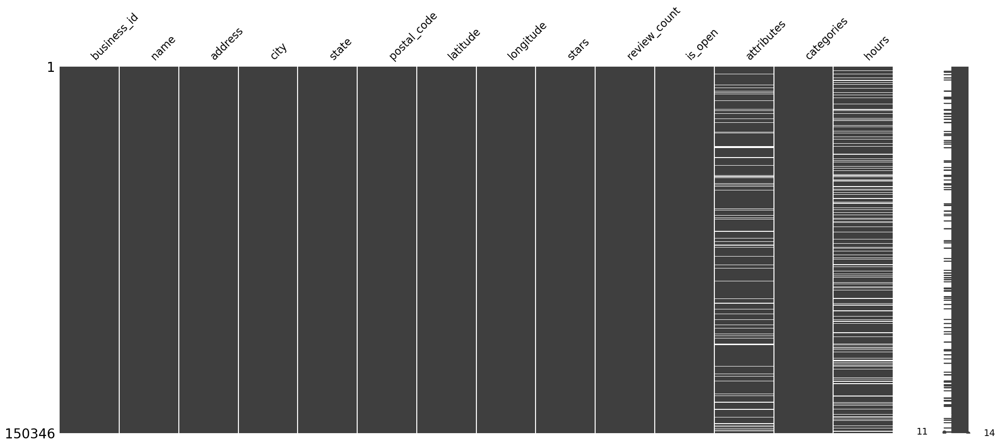

In [7]:
msno.matrix(df);

### Observations:
* At a first glance, we can see that quite a significant percentage of values in the columns `attributes` and `hours` are missing (about 9% and 15.5% respectively). From the plot, these values seem to be missing at random.
* A very small fraction (about 0.07%) of values in the `categories` column are missing.
* We will have to check if we can fill in these missing values without changing the overall distribution of the columns. For the `categories` column, we may be able to get away with just dropping the missing rows.

## Column-wise analysis

### `name`

In [8]:
df["name"].dtype

dtype('O')

In [9]:
df["name"].value_counts()

name
Starbucks                              724
McDonald's                             703
Dunkin'                                510
Subway                                 459
Taco Bell                              365
                                      ... 
BAP                                      1
Herb Import Co                           1
The Vac & Sew Center                     1
Adelita Taqueria & Restaurant            1
St. Vincent Heart Center of Indiana      1
Name: count, Length: 114117, dtype: int64

In [10]:
df["name"].value_counts(normalize=True)

name
Starbucks                              0.004816
McDonald's                             0.004676
Dunkin'                                0.003392
Subway                                 0.003053
Taco Bell                              0.002428
                                         ...   
BAP                                    0.000007
Herb Import Co                         0.000007
The Vac & Sew Center                   0.000007
Adelita Taqueria & Restaurant          0.000007
St. Vincent Heart Center of Indiana    0.000007
Name: proportion, Length: 114117, dtype: float64

In [11]:
print(f"The data has {len(df)} rows.")

The data has 150346 rows.


#### Observations
* This column represents the name of the business.
* Some `name`s are repeating. However, this is because the same business has multiple outlets. For instance, Starbucks, McDonald's, Dunkin', Subway, and Taco Bell are the top 5 businesses with it comes to number of outlets.
* The number of unique values in this column are 114,117, which is comparable to the the total rows in the data which are 150,346.

### `address`

In [12]:
df["address"].dtype

dtype('O')

In [13]:
df["address"].value_counts()

address
                             5127
160 N Gulph Rd                 86
51 N 12th St                   55
1 Terminal Dr                  52
4100 George J Bean Pkwy        46
                             ... 
6020 West Hospitality Rd        1
979 Fir St                      1
2821 N Ballas Rd, Ste 163       1
1638 Pine St, Fl 1              1
10580 N Meridian St             1
Name: count, Length: 122844, dtype: int64

In [14]:
df["address"].value_counts(normalize=True)

address
                             0.034101
160 N Gulph Rd               0.000572
51 N 12th St                 0.000366
1 Terminal Dr                0.000346
4100 George J Bean Pkwy      0.000306
                               ...   
6020 West Hospitality Rd     0.000007
979 Fir St                   0.000007
2821 N Ballas Rd, Ste 163    0.000007
1638 Pine St, Fl 1           0.000007
10580 N Meridian St          0.000007
Name: proportion, Length: 122844, dtype: float64

In [15]:
print(f"The data has {len(df)} rows.")

The data has 150346 rows.


#### Observations
* Some businesses seem to have black spaces in the `address` column. We may have to treat these blank spaces as missing values.
* Some businesses have the same addresses, possibly indicating shared office spaces.
* The number of unique values in this column are 122,844, which is comparable to the the total rows in the data which are 150,346.

### `city`

In [16]:
df["city"].dtype

dtype('O')

In [17]:
df["city"].value_counts()

city
Philadelphia               14569
Tucson                      9250
Tampa                       9050
Indianapolis                7540
Nashville                   6971
                           ...  
Apopka                         1
Fallsington                    1
Chattanooga                    1
WILLOW GROVE                   1
Clearwater/ Countryside        1
Name: count, Length: 1416, dtype: int64

In [18]:
df["city"].value_counts(normalize=True)

city
Philadelphia               0.096903
Tucson                     0.061525
Tampa                      0.060194
Indianapolis               0.050151
Nashville                  0.046366
                             ...   
Apopka                     0.000007
Fallsington                0.000007
Chattanooga                0.000007
WILLOW GROVE               0.000007
Clearwater/ Countryside    0.000007
Name: proportion, Length: 1416, dtype: float64

#### Observations
* Most businesses in this data are in Philadelphia.
* The number of cities in this data are 1,416, which is orders of magnitude lesser compared to the the total rows in the data which are 150,346.

### `state`

In [19]:
df["state"].dtype

dtype('O')

In [20]:
df["state"].value_counts()

state
PA     34039
FL     26330
TN     12056
IN     11247
MO     10913
LA      9924
AZ      9912
NJ      8536
NV      7715
AB      5573
CA      5203
ID      4467
DE      2265
IL      2145
TX         4
CO         3
HI         2
MA         2
WA         2
UT         1
NC         1
MI         1
MT         1
SD         1
XMS        1
VI         1
VT         1
Name: count, dtype: int64

In [21]:
df["state"].value_counts(normalize=True)

state
PA     0.226404
FL     0.175129
TN     0.080188
IN     0.074807
MO     0.072586
LA     0.066008
AZ     0.065928
NJ     0.056776
NV     0.051315
AB     0.037068
CA     0.034607
ID     0.029711
DE     0.015065
IL     0.014267
TX     0.000027
CO     0.000020
HI     0.000013
MA     0.000013
WA     0.000013
UT     0.000007
NC     0.000007
MI     0.000007
MT     0.000007
SD     0.000007
XMS    0.000007
VI     0.000007
VT     0.000007
Name: proportion, dtype: float64

In [22]:
len(df["state"].value_counts())

27

#### Observations
* Most businesses are in the state PA (Pennsylvania), which aligns with the fact that most businesses are in the city Philadelphia.
* This data contains only 27 states.

### `postal_code`

In [23]:
df["postal_code"].dtype

dtype('O')

In [24]:
df["postal_code"].value_counts()

postal_code
93101      1866
89502      1804
70130      1512
19103      1362
19107      1353
           ... 
37077         1
28217         1
T5P 4J5       1
T6V 1J1       1
T6N 0A4       1
Name: count, Length: 3362, dtype: int64

In [25]:
df["postal_code"].value_counts(normalize=True)

postal_code
93101      0.012411
89502      0.011999
70130      0.010057
19103      0.009059
19107      0.008999
             ...   
37077      0.000007
28217      0.000007
T5P 4J5    0.000007
T6V 1J1    0.000007
T6N 0A4    0.000007
Name: proportion, Length: 3362, dtype: float64

#### Observations
* This data contains 3,362 postal codes.

### `latitude`

In [26]:
df["latitude"].dtype

dtype('float64')

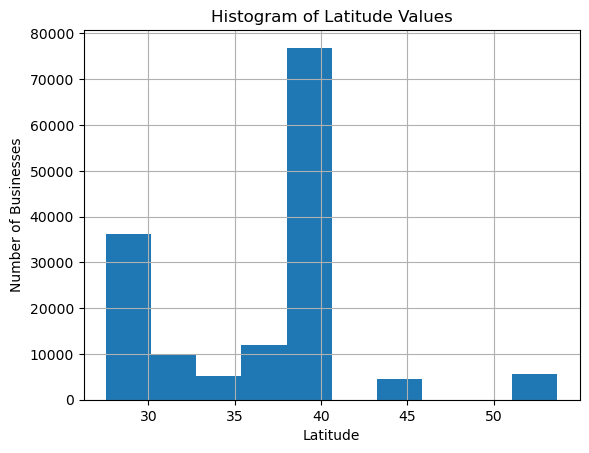

In [27]:
df["latitude"].hist()
plt.xlabel("Latitude")
plt.ylabel("Number of Businesses")
plt.title("Histogram of Latitude Values")
plt.show();

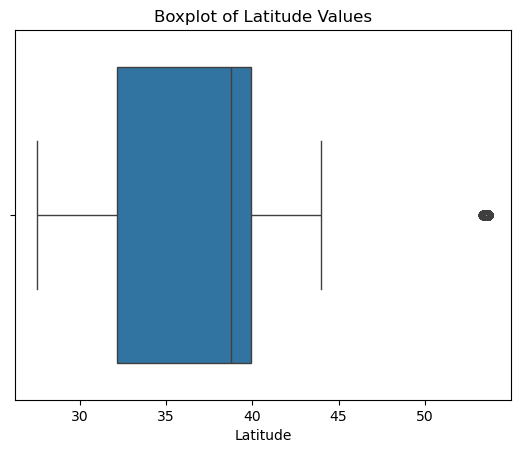

In [28]:
sns.boxplot(x=df["latitude"])
plt.title("Boxplot of Latitude Values")
plt.xlabel("Latitude")
plt.show();

#### Observations
* The distribution of `latitude`s is not at all close to Gaussian.
* The boxplot indicates some extreme values, however they most probably are not outliers as this column indicates the latitude coordinate, which is not like a usual numerical column where higher value means higher quantity. In other words, higher `latitude` does not indicate a high value of some measured quantity that may indicate that it is an outlier.

### `longitude`

In [29]:
df["longitude"].dtype

dtype('float64')

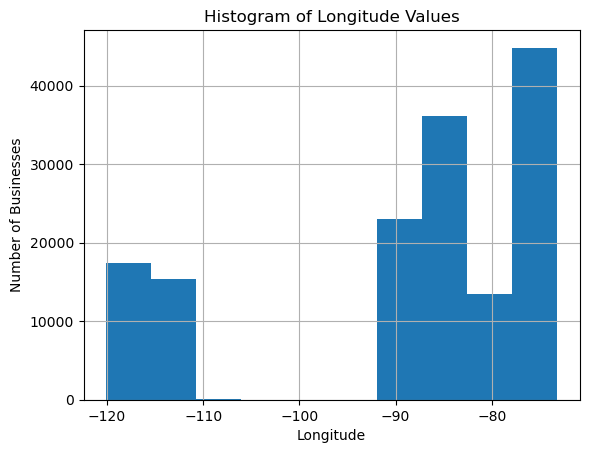

In [30]:
df["longitude"].hist()
plt.xlabel("Longitude")
plt.ylabel("Number of Businesses")
plt.title("Histogram of Longitude Values")
plt.show();

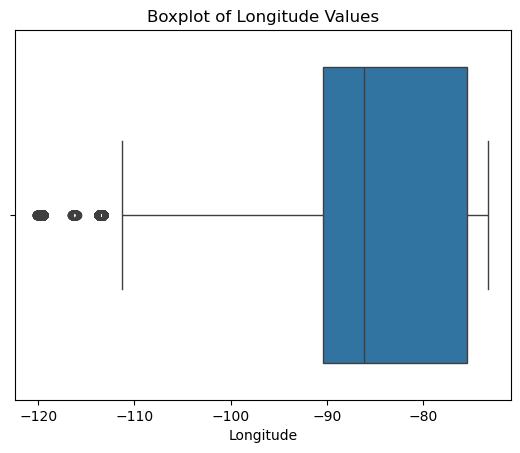

In [31]:
sns.boxplot(x=df["longitude"])
plt.title("Boxplot of Longitude Values")
plt.xlabel("Longitude")
plt.show();

The same observations apply to the `longitude` column.

### Plotting businesses on a map using `latitude` and `longitude`

In [32]:
fig = px.scatter_map(
    df,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    zoom=3,
    map_style="carto-positron"
)
fig.show()

We can clearly see the clusters in different cities.

### `stars`

In [33]:
df["stars"].dtype

dtype('float64')

According to the description, `stars` indicate the star ratings which are rounded to half-stars. So, a barplot would make more sense.

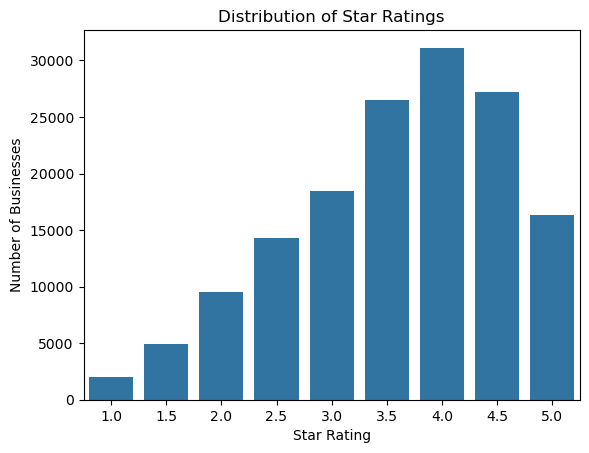

In [34]:
star_counts = df["stars"].value_counts().sort_index()
sns.barplot(x=star_counts.index, y=star_counts.values)
plt.xlabel("Star Rating")
plt.ylabel("Number of Businesses")
plt.title("Distribution of Star Ratings")
plt.show();

#### Observations
* Most of the businesses have a star rating of 4.
* The distribution looks a bit close to Gaussian.

### `review_count`

In [35]:
df["review_count"].dtype

dtype('int64')

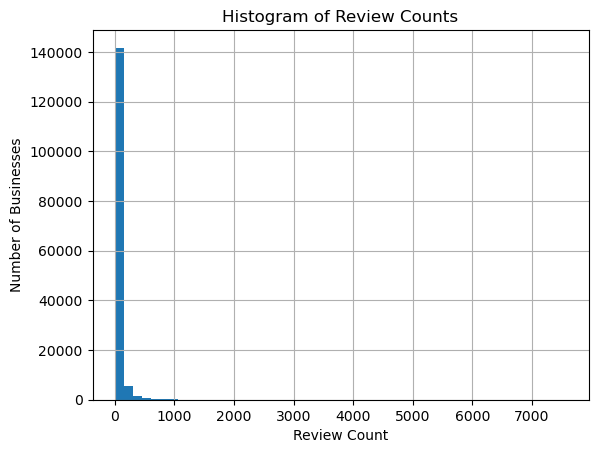

In [36]:
df["review_count"].hist(bins=50)
plt.xlabel("Review Count")
plt.ylabel("Number of Businesses")
plt.title("Histogram of Review Counts")
plt.show();

In [37]:
df["review_count"].value_counts()

review_count
5       14921
6       11673
7        9594
8        8040
9        6875
        ...  
1232        1
3054        1
5193        1
1485        1
637         1
Name: count, Length: 1158, dtype: int64

In [38]:
df["review_count"].value_counts(normalize=True)

review_count
5       0.099244
6       0.077641
7       0.063813
8       0.053477
9       0.045728
          ...   
1232    0.000007
3054    0.000007
5193    0.000007
1485    0.000007
637     0.000007
Name: proportion, Length: 1158, dtype: float64

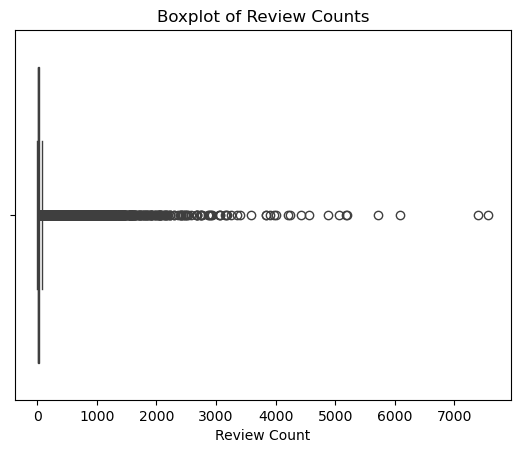

In [39]:
sns.boxplot(x=df["review_count"])
plt.title("Boxplot of Review Counts")
plt.xlabel("Review Count")
plt.show();

#### Observations
* We can clearly see that the distribution has an extreme right skew.
* The vast majority of businesses have `review_count`s between 1 and 500.
* There are some businesses who have been given an extraordinarily large number of `review_count`s, around 7,000.
* We may have to use some proper transformation technique, like log transformation, on this column to bring its distribution closer to Gaussian.

### `is_open`

In [40]:
df["is_open"].dtype

dtype('int64')

This is a binary column, hence a barplot makes more sense.

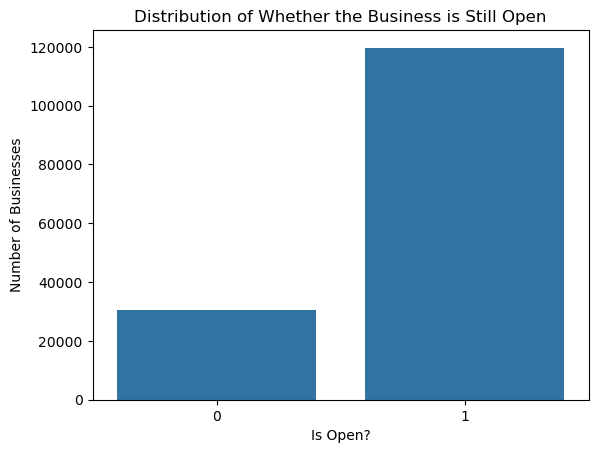

In [41]:
is_open = df["is_open"].value_counts().sort_index()
sns.barplot(x=is_open.index, y=is_open.values)
plt.xlabel("Is Open?")
plt.ylabel("Number of Businesses")
plt.title("Distribution of Whether the Business is Still Open")
plt.show();

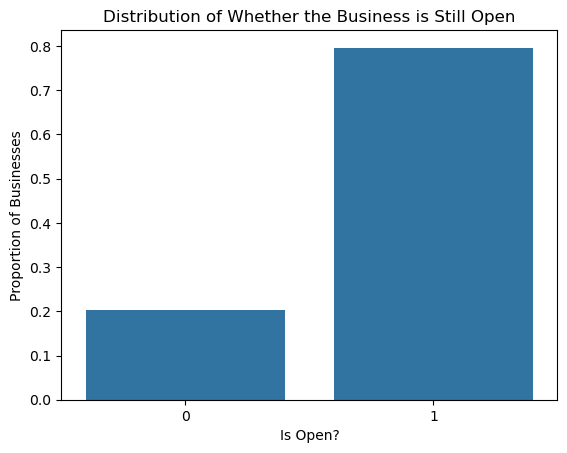

In [42]:
is_open = df["is_open"].value_counts(normalize=True).sort_index()
sns.barplot(x=is_open.index, y=is_open.values)
plt.xlabel("Is Open?")
plt.ylabel("Proportion of Businesses")
plt.title("Distribution of Whether the Business is Still Open")
plt.show();

#### Observations
* Most businesses, about 80%, are still open.

### `attributes`

In [44]:
# unique_attribute_keys = set()

# for row in df["attributes"].dropna():
#     unique_attribute_keys.update(row.keys())

# print(unique_attribute_keys)

## Multivariate Plots

### `stars` vs. `review_count`

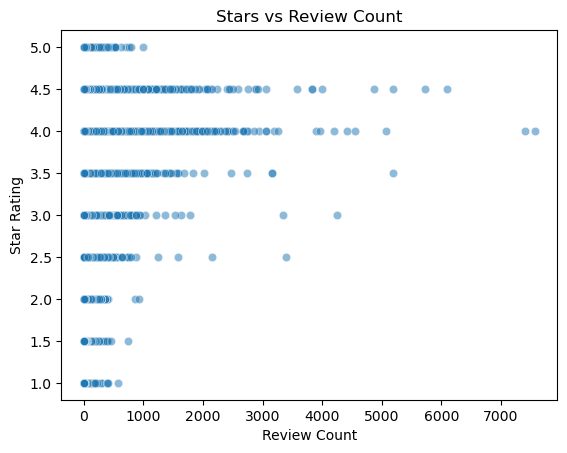

In [51]:
sns.scatterplot(data=df, x="review_count", y="stars", alpha=0.5)
plt.title("Stars vs Review Count")
plt.xlabel("Review Count")
plt.ylabel("Star Rating")
plt.show();

#### Observations
* The number of reviews a business receives is more or less increasing with its star rating.

### `is_open` vs. Average `rating`

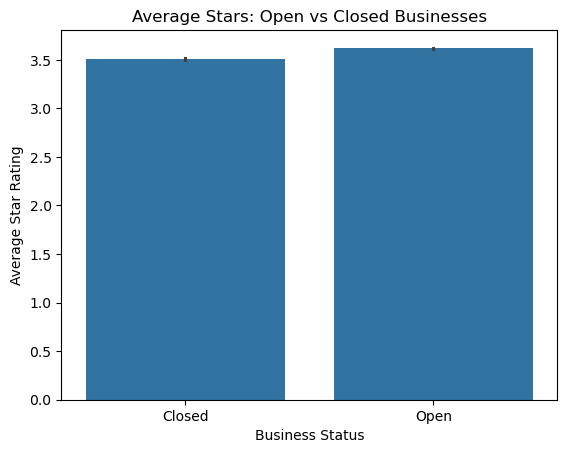

In [55]:
sns.barplot(data=df, x="is_open", y="stars")
plt.xticks([0, 1], ["Closed", "Open"])
plt.title("Average Stars: Open vs Closed Businesses")
plt.xlabel("Business Status")
plt.ylabel("Average Star Rating")
plt.show();

#### Observations
* The average rating looks more or less the same whether the business was open or closed.

# Checkin data

In [70]:
df = pd.read_json(CHECKIN_DATA_PATH, lines=True)
df.head()

,business_id,date
0,---kPU91CF4Lq2-WlRu9Lw,"2020-03-13 21:10:56, 2020-06-02 22:18:06, 2020..."
1,--0iUa4sNDFiZFrAdIWhZQ,"2010-09-13 21:43:09, 2011-05-04 23:08:15, 2011..."
2,--30_8IhuyMHbSOcNWd6DQ,"2013-06-14 23:29:17, 2014-08-13 23:20:22"
3,--7PUidqRWpRSpXebiyxTg,"2011-02-15 17:12:00, 2011-07-28 02:46:10, 2012..."
4,--7jw19RH9JKXgFohspgQw,"2014-04-21 20:42:11, 2014-04-28 21:04:46, 2014..."


## Checking for missing values

In [71]:
df.isnull().sum()

business_id    0
date           0
dtype: int64

There are no missing values.

## Number of Businesses with Check-ins

In [60]:
print(f"Number of businesses with check-ins: {df['business_id'].nunique()}.")

Number of businesses with check-ins: 131930.


## Total Number of Check-ins Across All Businesses

In [62]:
total_checkins = df["date"].dropna().str.count(",").sum() + len(df["date"].dropna())
print(f"Total number of check-ins across all businesses: {total_checkins}.")

Total number of check-ins across all businesses: 13356875.


# Review data

The review data is too large for local memory. Hence, we will be loading a sample of this data with 1,000,000 rows.

In [109]:
df = pd.read_json(SAMPLE_REVIEW_DATA_PATH, lines=True)
df.head()

,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15


In [110]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 9 columns):
 #   Column       Non-Null Count    Dtype         
---  ------       --------------    -----         
 0   review_id    1000000 non-null  object        
 1   user_id      1000000 non-null  object        
 2   business_id  1000000 non-null  object        
 3   stars        1000000 non-null  int64         
 4   useful       1000000 non-null  int64         
 5   funny        1000000 non-null  int64         
 6   cool         1000000 non-null  int64         
 7   text         1000000 non-null  object        
 8   date         1000000 non-null  datetime64[ns]
dtypes: datetime64[ns](1), int64(4), object(4)
memory usage: 68.7+ MB


In [111]:
df.describe()

,stars,useful,funny,cool,date
count,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000
mean,3.783959,1.106594,0.307812,0.457129,2016-07-13 10:09:02.464016128
min,1.000000,0.000000,0.000000,0.000000,2005-03-01 17:47:15
25%,3.000000,0.000000,0.000000,0.000000,2014-08-07 16:29:16.500000
50%,4.000000,0.000000,0.000000,0.000000,2016-10-11 16:02:42
75%,5.000000,1.000000,0.000000,0.000000,2018-09-01 01:26:22.249999872
max,5.000000,539.000000,284.000000,172.000000,2022-01-19 19:47:59
std,1.440197,2.848906,1.428185,1.799114,NaN


## Checking for missing values

In [112]:
df.isnull().sum()

review_id      0
user_id        0
business_id    0
stars          0
useful         0
funny          0
cool           0
text           0
date           0
dtype: int64

There are no missing values.

## Column-wise analysis

### `user_id`

In [113]:
print(f"Number of unique users: {df['user_id'].nunique()}.")
print("\n")
# Top 10 most active users
top_users = df["user_id"].value_counts().head(10)
print(f"The top-10 users are:")
print(top_users)

Number of unique users: 542003.


The top-10 users are:
user_id
_BcWyKQL16ndpBdggh2kNA    483
Xw7ZjaGfr0WNVt6s_5KZfA    283
0Igx-a1wAstiBDerGxXk2A    264
bYENop4BuQepBjM1-BI3fA    240
-G7Zkl1wIWBBmD0KRy_sCw    224
ouODopBKF3AqfCkuQEnrDg    210
1HM81n6n4iPIFU5d2Lokhw    209
Um5bfs5DH6eizgjH3xZsvg    208
qjfMBIZpQT9DDtw_BWCopQ    203
ET8n-r7glWYqZhuR6GcdNw    199
Name: count, dtype: int64


### `business_id`

In [114]:
print(f"Number of unique businesses: {df['business_id'].nunique()}.")
print("\n")
# Top reviewed businesses
top_businesses = df["business_id"].value_counts().head(10)
print(f"The top-10 most reviewed businesses are:")
print(top_businesses)

Number of unique businesses: 27095.


The top-10 most reviewed businesses are:
business_id
GBTPC53ZrG1ZBY3DT8Mbcw    4661
PY9GRfzr4nTZeINf346QOw    2715
SZU9c8V2GuREDN5KgyHFJw    2444
UCMSWPqzXjd7QHq7v8PJjQ    2230
vN6v8m4DO45Z4pp8yxxF_w    2120
W4ZEKkva9HpAdZG88juwyQ    2116
8uF-bhJFgT4Tn6DTb27viA    2110
pSmOH4a3HNNpYM82J5ycLA    2091
Zi-F-YvyVOK0k5QD7lrLOg    2008
g04aAvgol7IW8buqSbT4xA    1891
Name: count, dtype: int64


### `stars`

In [115]:
df["stars"].dtype

dtype('int64')

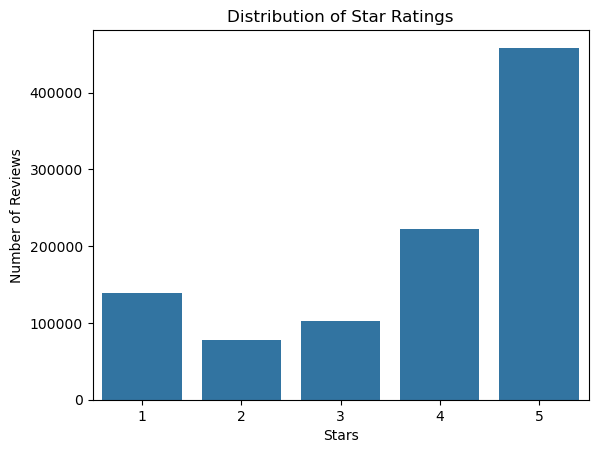

In [116]:
sns.countplot(x="stars", data=df)
plt.title("Distribution of Star Ratings")
plt.xlabel("Stars")
plt.ylabel("Number of Reviews")
plt.show();

#### Observations
* Most number reviews resulted in 5 stars, whereas the least number of reviews resulted in 2 stars.
* The number of 5-star reviews is significantly higher than the other reviews. It is almost double the next highest star review which is 4-star.

### `useful`

In [117]:
df["useful"].dtype

dtype('int64')

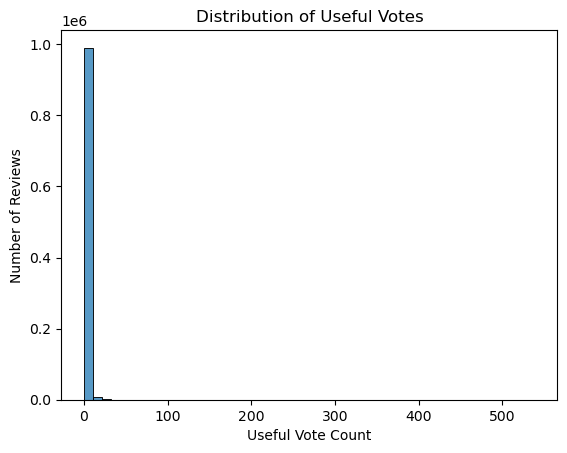

In [118]:
sns.histplot(data=df, x="useful", bins=50, kde=False)
plt.title("Distribution of Useful Votes")
plt.xlabel("Useful Vote Count")
plt.ylabel("Number of Reviews")
plt.show();

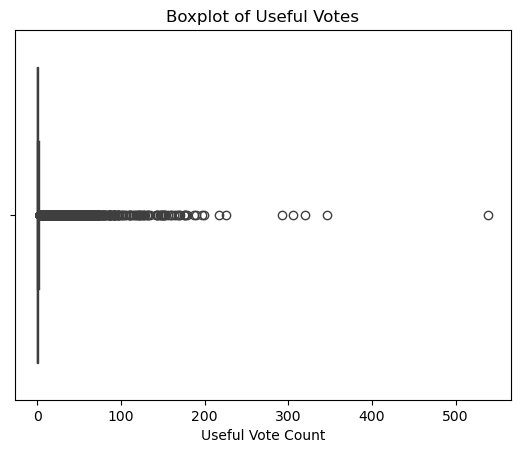

In [119]:
sns.boxplot(data=df, x="useful")
plt.title("Boxplot of Useful Votes")
plt.xlabel("Useful Vote Count")
plt.show();

#### Observations
* The `useful` column is highly right-skewed. In other words, the vast majority of reviews have a `useful` value of 0.

### `funny`

In [120]:
df["funny"].dtype

dtype('int64')

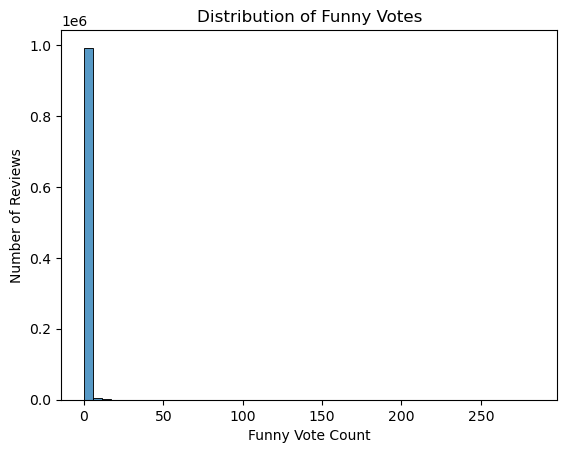

In [121]:
sns.histplot(data=df, x="funny", bins=50, kde=False)
plt.title("Distribution of Funny Votes")
plt.xlabel("Funny Vote Count")
plt.ylabel("Number of Reviews")
plt.show();

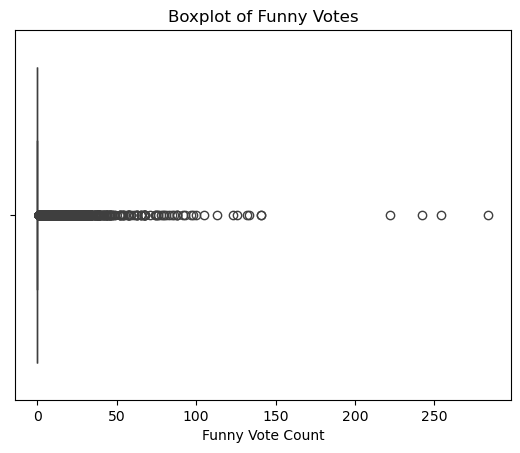

In [122]:
sns.boxplot(data=df, x="funny")
plt.title("Boxplot of Funny Votes")
plt.xlabel("Funny Vote Count")
plt.show();

#### Observations
* The `funny` column is highly right-skewed. In other words, the vast majority of reviews have a `funny` value of 0.

### `cool`

In [123]:
df["cool"].dtype

dtype('int64')

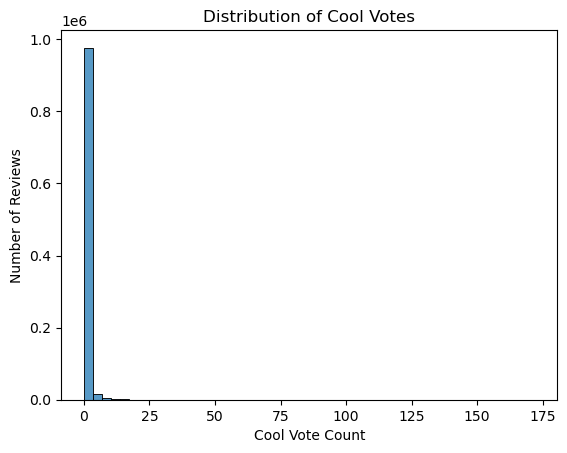

In [124]:
sns.histplot(data=df, x="cool", bins=50, kde=False)
plt.title("Distribution of Cool Votes")
plt.xlabel("Cool Vote Count")
plt.ylabel("Number of Reviews")
plt.show();

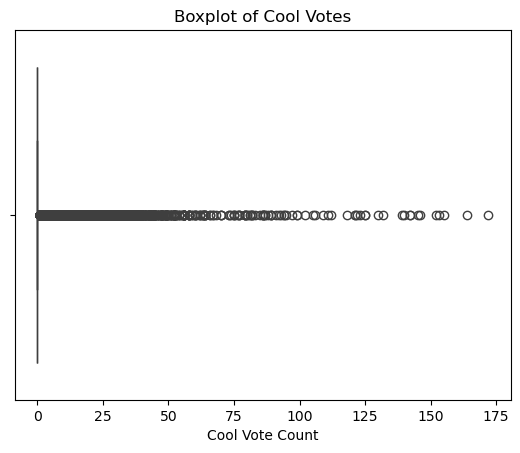

In [125]:
sns.boxplot(data=df, x="cool")
plt.title("Boxplot of Cool Votes")
plt.xlabel("Cool Vote Count")
plt.show();

#### Observations
* The `cool` column is highly right-skewed. In other words, the vast majority of reviews have a `cool` value of 0.

### Number of Reviews over time

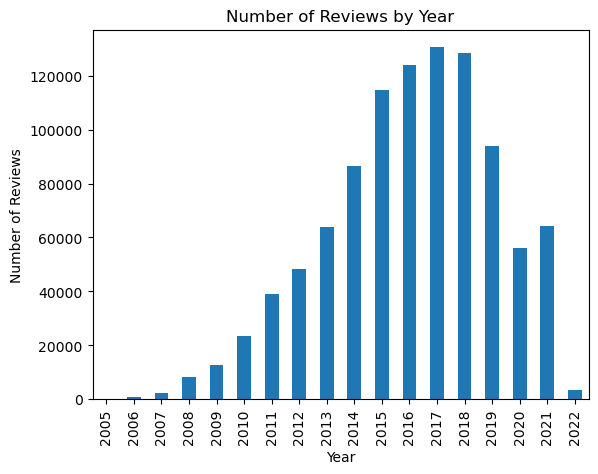

In [126]:
df["year"] = df["date"].dt.year
df["year"].value_counts().sort_index().plot(kind="bar")
plt.title("Number of Reviews by Year")
plt.xlabel("Year")
plt.ylabel("Number of Reviews")
plt.show();

#### Observations
* Most reviews are from the years 2014 to 2019, with the peak year being 2017.

In [127]:
df["month"] = df["date"].dt.strftime("%b")

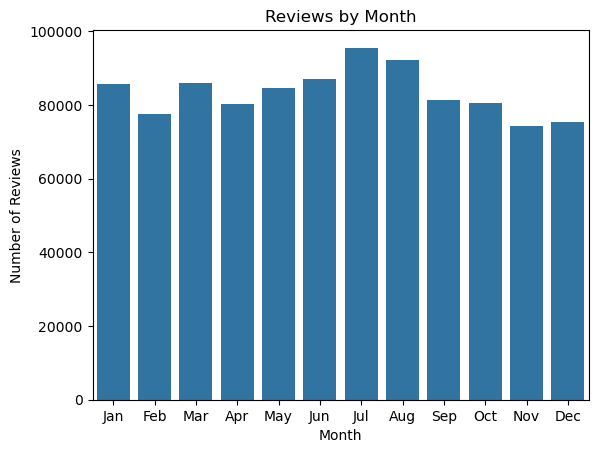

In [128]:
month_order = [
    "Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"
]

sns.countplot(x="month", data=df, order=month_order)
plt.title("Reviews by Month")
plt.xlabel("Month")
plt.ylabel("Number of Reviews")
plt.show();

#### Observations
* The distribution looks more or less normal for each month.

### Vote columns

In [129]:
vote_cols = ["useful", "funny", "cool"]

In [130]:
df[vote_cols].describe()

,useful,funny,cool
count,1000000.000000,1000000.000000,1000000.000000
mean,1.106594,0.307812,0.457129
std,2.848906,1.428185,1.799114
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000
75%,1.000000,0.000000,0.000000
max,539.000000,284.000000,172.000000


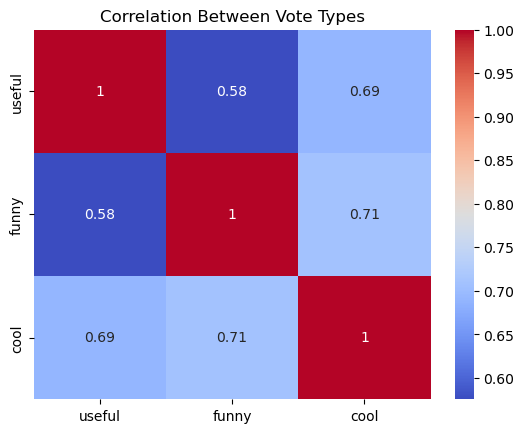

In [131]:
sns.heatmap(df[vote_cols].corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Between Vote Types")
plt.show();

#### Observations
* Clearly, there is high correlation between vote types. This means that if a review has a particular vote type, then it is quite likely that it will have the other two vote types too.

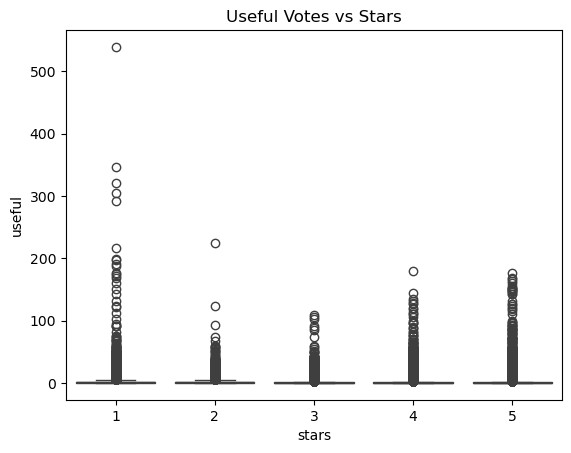

In [132]:
sns.boxplot(x="stars", y="useful", data=df)
plt.title("Useful Votes vs Stars")
plt.show();

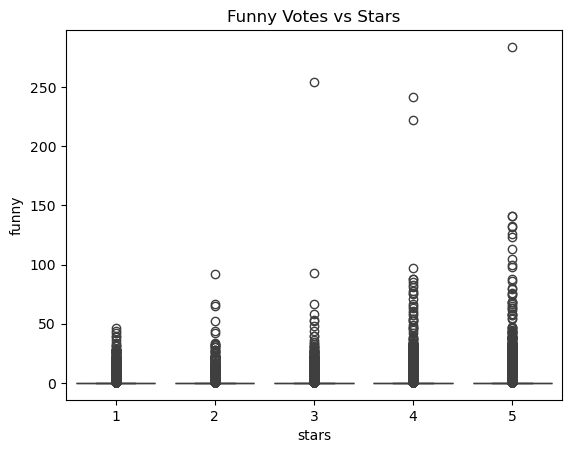

In [133]:
sns.boxplot(x="stars", y="funny", data=df)
plt.title("Funny Votes vs Stars")
plt.show();

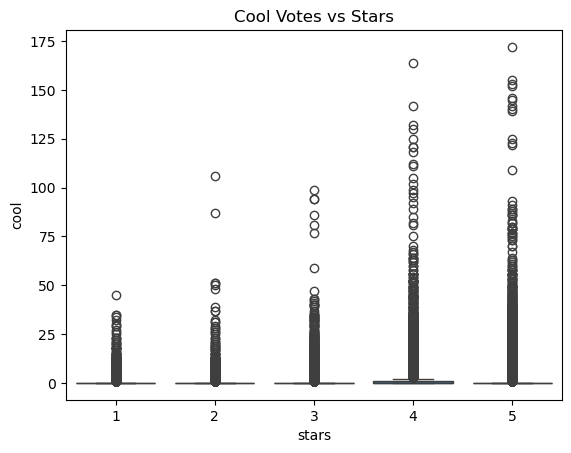

In [134]:
sns.boxplot(x="stars", y="cool", data=df)
plt.title("Cool Votes vs Stars")
plt.show();

#### Observations
* There doesn't seem to be a pattern with `useful` votes vs. `stars`.
* The number of `funny` and `cool` votes seem to be more for reviews with higher `stars`.

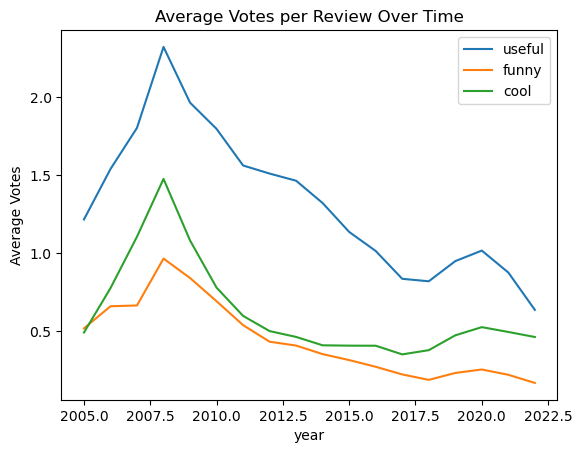

In [135]:
df.groupby("year")[["useful", "funny", "cool"]].mean().plot()
plt.title("Average Votes per Review Over Time")
plt.ylabel("Average Votes")
plt.show();

#### Observations
* The average votes for all three types of votes seem to have peaked at the same point in time.

# Tip data

In [136]:
df = pd.read_json(TIP_DATA_PATH, lines=True)
df.head()

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0


In [137]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 908915 entries, 0 to 908914
Data columns (total 5 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   user_id           908915 non-null  object        
 1   business_id       908915 non-null  object        
 2   text              908915 non-null  object        
 3   date              908915 non-null  datetime64[ns]
 4   compliment_count  908915 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(3)
memory usage: 34.7+ MB


In [138]:
df.describe()

,date,compliment_count
count,908915,908915.000000
mean,2015-06-14 10:13:53.302817280,0.012525
min,2009-04-16 13:11:49,0.000000
25%,2013-01-26 01:18:02.500000,0.000000
50%,2015-03-15 01:10:25,0.000000
75%,2017-08-02 06:19:55.500000,0.000000
max,2022-01-19 20:38:55,6.000000
std,NaN,0.120763


## Check for missing values

In [139]:
df.isnull().sum()

user_id             0
business_id         0
text                0
date                0
compliment_count    0
dtype: int64

There are no missing values.

## Column-wise analysis

### `user_id`

In [147]:
print("The top-10 tip givers are:")
print("\n")
print(df["user_id"].value_counts().head(10))

The top-10 tip givers are:


user_id
fCvMnJU1Z-XhAjKg99wK3Q    4071
5Y5KbsI5buMcNh2hTFaRpA    1385
lMY8NBPyzlPbbu-KBYfD9A    1373
qjfMBIZpQT9DDtw_BWCopQ    1230
Rr4cLb6Go91FT134o6RsKg    1230
-G7Zkl1wIWBBmD0KRy_sCw    1035
sraTrYU-7q_bQ0TxQrLJvQ     902
I2XpWCHAom1JRyHXZQrnfg     821
xWmYN57XXZbg0LOK8WbbFQ     813
zYFGMy1_thjMnvQLX6JNBw     782
Name: count, dtype: int64


### `business_id`

In [140]:
print(f"Number of unique businesses: {df['business_id'].nunique()}.")
print("\n")
# Top reviewed businesses
top_businesses = df["business_id"].value_counts().head(10)
print(f"The top-10 most tipped businesses are:")
print(top_businesses)

Number of unique businesses: 106193.


The top-10 most tipped businesses are:
business_id
FEXhWNCMkv22qG04E83Qjg    2571
-QI8Qi8XWH3D8y8ethnajA    1011
_ab50qdWOk0DdB6XOrBitw     932
ytynqOUb3hjKeJfRj5Tshw     827
Eb1XmmLWyt_way5NNZ7-Pw     826
c_4c5rJECZSfNgFj7frwHQ     750
ac1AeYqs8Z4_e2X5M3if2A     613
GBTPC53ZrG1ZBY3DT8Mbcw     608
iSRTaT9WngzB8JJ2YKJUig     606
GXFMD0Z4jEVZBCsbPf4CTQ     579
Name: count, dtype: int64


### `compliment_count`

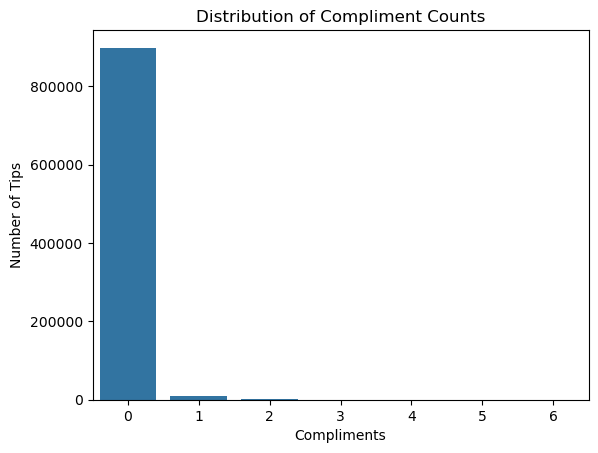

In [142]:
sns.countplot(x="compliment_count", data=df)
plt.title("Distribution of Compliment Counts")
plt.xlabel("Compliments")
plt.ylabel("Number of Tips")
plt.show();

#### Observation
* There were no compliments received for most tips.

## Tips over time

### Over the years

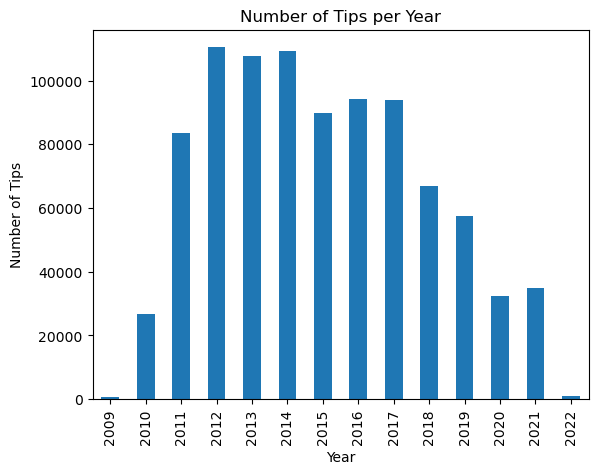

In [143]:
df["year"] = df["date"].dt.year
df["year"].value_counts().sort_index().plot(kind="bar")
plt.title("Number of Tips per Year")
plt.xlabel("Year")
plt.ylabel("Number of Tips")
plt.show();

#### Observations
* Most tips were received from the year 2011 to 2019 with the peak year being 2012.

### Over the months

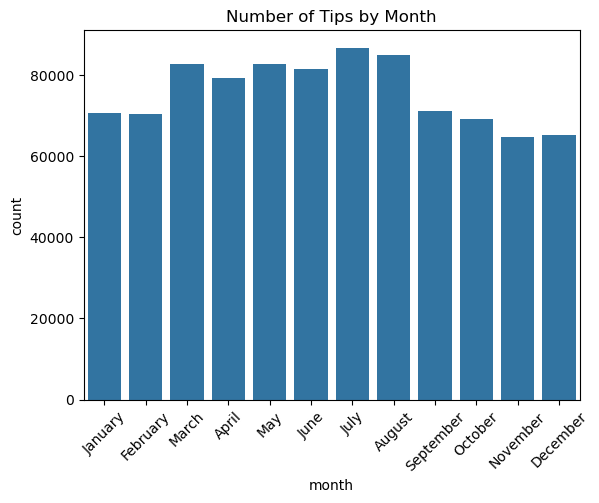

In [144]:
df["month"] = df["date"].dt.month_name()
month_order = ["January", "February", "March", "April", "May", "June",
               "July", "August", "September", "October", "November", "December"]
sns.countplot(x="month", data=df, order=month_order)
plt.xticks(rotation=45)
plt.title("Number of Tips by Month")
plt.show();

#### Observations
* The number of tips over the months is more or less uniformly distributed.

# User data

In [4]:
df = pd.read_json(USER_DATA_PATH, lines=True)
df["yelping_since"] = pd.to_datetime(df["yelping_since"])
df.head()

,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,...,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,...,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,...,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,...,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,...,1,0,0,0,1,1,0,0,0,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1987897 entries, 0 to 1987896
Data columns (total 22 columns):
 #   Column              Dtype         
---  ------              -----         
 0   user_id             object        
 1   name                object        
 2   review_count        int64         
 3   yelping_since       datetime64[ns]
 4   useful              int64         
 5   funny               int64         
 6   cool                int64         
 7   elite               object        
 8   friends             object        
 9   fans                int64         
 10  average_stars       float64       
 11  compliment_hot      int64         
 12  compliment_more     int64         
 13  compliment_profile  int64         
 14  compliment_cute     int64         
 15  compliment_list     int64         
 16  compliment_note     int64         
 17  compliment_plain    int64         
 18  compliment_cool     int64         
 19  compliment_funny    int64         
 20  co

In [6]:
df.describe()

,review_count,yelping_since,useful,funny,cool,fans,average_stars,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
count,1.987897e+06,1987897,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06,1.987897e+06
mean,2.339441e+01,2014-10-07 07:10:01.368328704,4.229634e+01,1.697054e+01,2.379291e+01,1.465740e+00,3.630494e+00,1.807072e+00,2.922631e-01,1.793176e-01,1.336493e-01,6.390723e-02,1.443135e+00,3.011841e+00,2.829308e+00,2.829308e+00,1.056448e+00,1.226859e+00
min,0.000000e+00,2004-10-12 08:46:11,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,2012-06-30 17:12:57,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,5.000000e+00,2014-10-12 15:09:56,3.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.880000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,1.700000e+01,2016-11-26 01:12:32,1.300000e+01,2.000000e+00,3.000000e+00,0.000000e+00,4.560000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,1.747300e+04,2022-01-19 17:15:47,2.062960e+05,1.858230e+05,1.998780e+05,1.249700e+04,5.000000e+00,2.578400e+04,1.350100e+04,1.418000e+04,1.365400e+04,1.266900e+04,5.903100e+04,1.010970e+05,4.996700e+04,4.996700e+04,1.593400e+04,8.263000e+04
std,8.256699e+01,NaN,6.414806e+02,4.078034e+02,5.653513e+02,1.813075e+01,1.183337e+00,7.360184e+01,1.282467e+01,1.515525e+01,1.135682e+01,1.004363e+01,6.016790e+01,1.193898e+02,9.666385e+01,9.666385e+01,3.217973e+01,9.515751e+01


## Check for missing values

In [7]:
df.isnull().sum()

user_id               0
name                  0
review_count          0
yelping_since         0
useful                0
funny                 0
cool                  0
elite                 0
friends               0
fans                  0
average_stars         0
compliment_hot        0
compliment_more       0
compliment_profile    0
compliment_cute       0
compliment_list       0
compliment_note       0
compliment_plain      0
compliment_cool       0
compliment_funny      0
compliment_writer     0
compliment_photos     0
dtype: int64

There are no missing values in the data.

## Column-wise analysis

### `user_id`

In [8]:
df["user_id"].nunique()

1987897

This column has unique values in all the rows.

### `name`

In [9]:
print("The most common names of users are:")
print(df["name"].value_counts().head(10))

The most common names of users are:
name
John        18719
Michael     16645
David       15967
Chris       14591
Mike        13390
Jennifer    13275
Sarah       11893
Jessica     11688
Lisa        10623
Michelle     9804
Name: count, dtype: int64


### `review_count`

In [10]:
df["review_count"].dtype

dtype('int64')

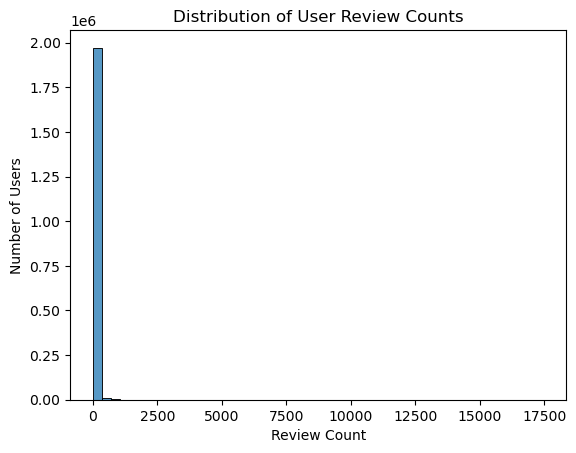

In [11]:
sns.histplot(df["review_count"], bins=50)
plt.title("Distribution of User Review Counts")
plt.xlabel("Review Count")
plt.ylabel("Number of Users")
plt.show();

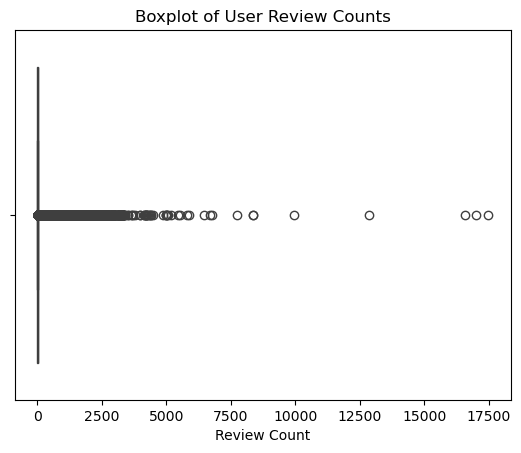

In [12]:
sns.boxplot(data=df, x="review_count")
plt.title("Boxplot of User Review Counts")
plt.xlabel("Review Count")
plt.show();

#### Observations
* The `review_count` column is highly right-skewed.

### `average_stars`

In [13]:
df["average_stars"].dtype

dtype('float64')

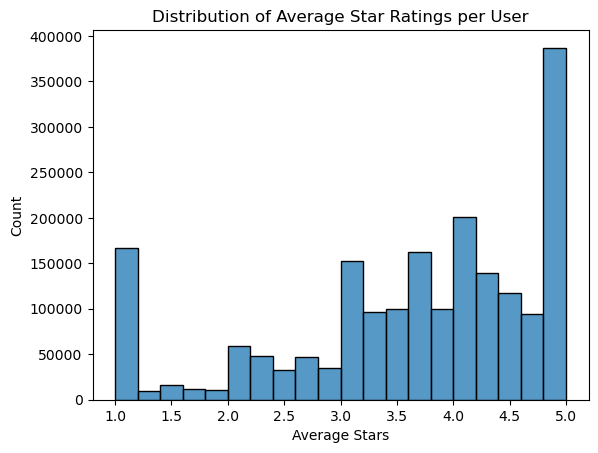

In [14]:
sns.histplot(df["average_stars"], bins=20)
plt.title("Distribution of Average Star Ratings per User")
plt.xlabel("Average Stars")
plt.show();

## Number of users joined over the years

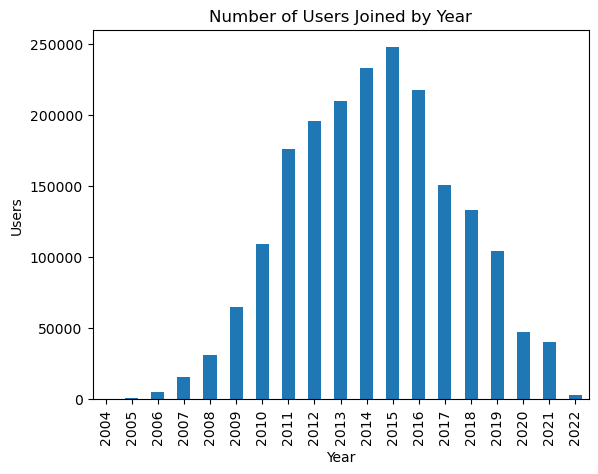

In [15]:
df["year_joined"] = df["yelping_since"].dt.year
df["year_joined"].value_counts().sort_index().plot(kind="bar")
plt.title("Number of Users Joined by Year")
plt.xlabel("Year")
plt.ylabel("Users")
plt.show();

#### Observations
* Most users joined from the years 2011 to 2018, with the peak year being 2015.

## Friend network

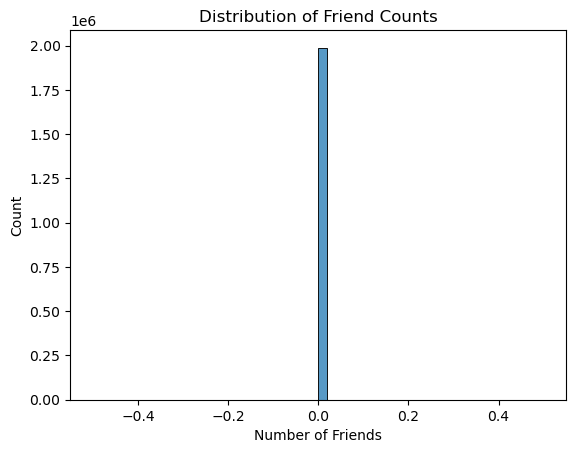

In [16]:
df["friend_count"] = df["friends"].apply(lambda x: len(x) if isinstance(x, list) else 0)

sns.histplot(df["friend_count"], bins=50)
plt.title("Distribution of Friend Counts")
plt.xlabel("Number of Friends")
plt.show();

#### Observations
* The vast majority of people have a `friend_count` of 0.

## Compliment counts

The users that are the top complimented are the following:

In [17]:
compliment_cols = [col for col in df.columns if col.startswith("compliment_")]
df["total_compliments"] = df[compliment_cols].sum(axis=1)
df.nlargest(10, "total_compliments")[["name", "total_compliments"] + compliment_cols]

,name,total_compliments,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
200787,Richard,324328,21353,4138,6411,2974,2413,13970,101097,49967,49967,15934,56104
400147,Brian,277314,24348,13501,14180,13654,12669,15927,24943,30008,30008,15446,82630
800350,Rohlin,154351,14193,3838,4309,1986,1738,7627,25745,28248,28248,11052,27367
207385,Harald,133351,12073,2986,3144,1277,1096,4751,24260,23476,23476,8607,28205
202196,John,132032,25784,653,487,186,65,59031,5345,11718,11718,3178,13867
199261,Lolia,121940,25411,2240,4242,2516,1397,4864,11231,24970,24970,7260,12839
1790999,Nadine,99694,19033,579,472,406,54,5112,11488,20835,20835,4547,16333
617655,Carissa,88363,24464,321,626,219,64,38336,3377,6359,6359,1604,6634
223387,Dawne,87736,11841,265,138,85,13,4883,18005,15633,15633,667,20573
217667,Pamela,87324,21829,314,283,204,26,4191,9423,19889,19889,2614,8662


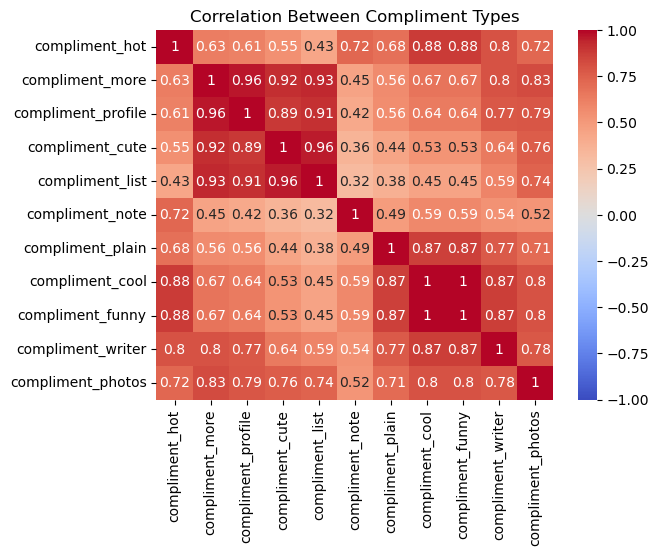

In [18]:
sns.heatmap(df[compliment_cols].corr(), annot=True, cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Between Compliment Types")
plt.show();

#### Observations
* Clearly, all the compliment columns are highly correlated with each other.